In [1]:
import numpy as np
import torch
import matplotlib
import matplotlib.pyplot as plt

import torchvision
from torchvision import transforms

## Grab the test data and visualise

In [2]:
data_path = "/home/sravula/experiments/datasets/8047_vel_imgs.npy"

In [3]:
from datasets.velocity_fine import Velocity

tran_transform = transforms.Compose([
    transforms.Resize([256, 256])
])

dataset = Velocity(path=data_path, transform=tran_transform)

In [4]:
N = len(dataset)
indices = list(range(N))
random_state = np.random.get_state()
np.random.seed(2240)
np.random.shuffle(indices)
np.random.set_state(random_state)
train_indices, test_indices = indices[:int(N * 0.9)], indices[int(N * 0.9):]

In [5]:
test_dataset = torch.utils.data.Subset(dataset, test_indices)

In [6]:
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=15, shuffle=False,
                         num_workers=8, drop_last=True)

test_iter = iter(test_loader)

test_sample = next(test_iter)[0]

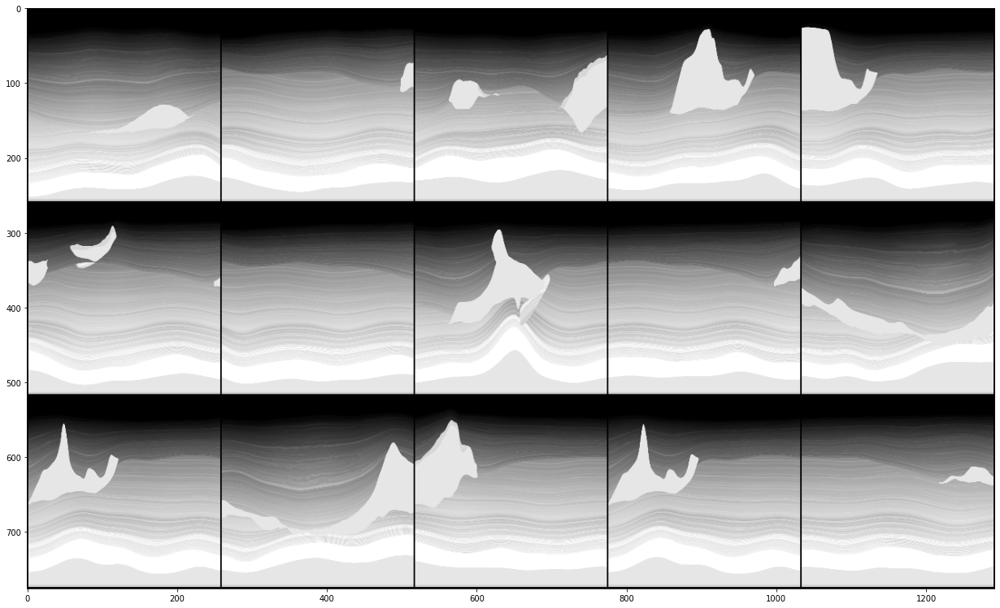

In [7]:
grid_img = torchvision.utils.make_grid(test_sample, nrow=5)

dpi = matplotlib.rcParams['figure.dpi']

height = width = 6*256
figsize = width / float(dpi), height / float(dpi)

plt.figure(figsize=figsize)
plt.imshow(grid_img.permute(1, 2, 0))
plt.show()

## Noise the test data and visualise

In [8]:
noisy_test_sample = test_sample + 0.3*torch.randn(test_sample.size())
noisy_test_sample = torch.clip(noisy_test_sample, min=0, max=1)

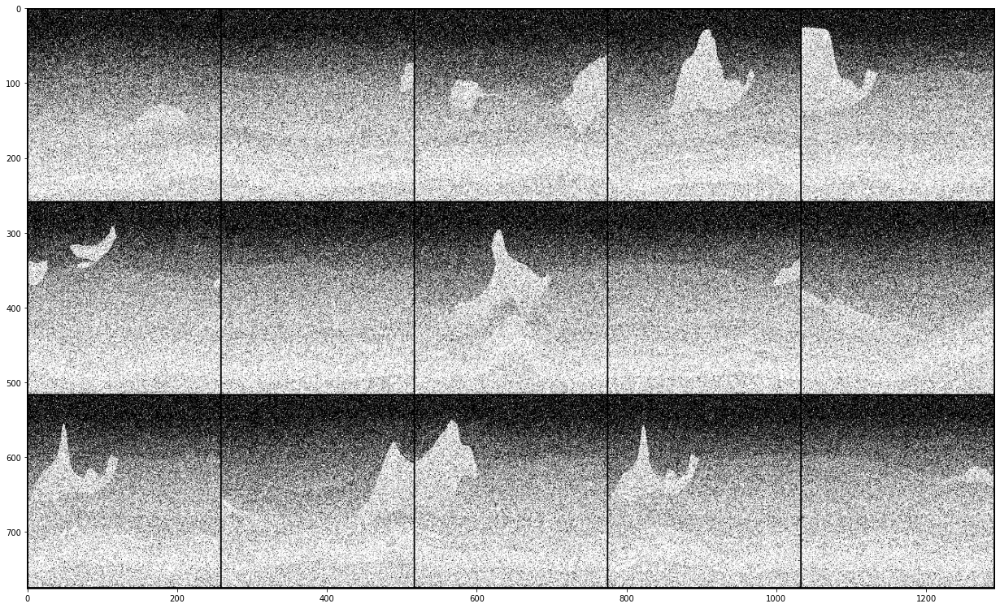

In [9]:
grid_img = torchvision.utils.make_grid(noisy_test_sample, nrow=5)

dpi = matplotlib.rcParams['figure.dpi']

height = width = 6*256
figsize = width / float(dpi), height / float(dpi)

plt.figure(figsize=figsize)
plt.imshow(grid_img.permute(1, 2, 0))
plt.show()

## Load the network and perform Langevin dynamics on the noisy images

In [10]:
ckpt_path = "/home/sravula/experiments/logs/run_2/checkpoint.pth"
config_path = "/home/sravula/ncsnv2/configs/velocity.yml"

In [11]:
import argparse
from main import dict2namespace
import yaml

with open(config_path, 'r') as f:
    config = yaml.load(f)
new_config = dict2namespace(config)

device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
new_config.device = device

print(device)

/home/sravula/venvs/ncsnv2/lib64/python3.6/site-packages/ipykernel_launcher.py:6: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  


cuda


In [12]:
from models.ncsnv2 import NCSNv2Deepest
from models.ema import EMAHelper
from models import get_sigmas

new_config.input_dim = new_config.data.image_size ** 2 * new_config.data.channels

score = NCSNv2Deepest(new_config).to(new_config.device)
score = torch.nn.DataParallel(score)

#Set up the exponential moving average
if new_config.model.ema:
    ema_helper = EMAHelper(mu=new_config.model.ema_rate)
    ema_helper.register(score)

states = torch.load(ckpt_path)
score.load_state_dict(states[0])
### Make sure we can resume with different eps
states[1]['param_groups'][0]['eps'] = new_config.optim.eps

if new_config.model.ema:
    ema_helper.load_state_dict(states[4])

#grab all L noise levels
sigmas = get_sigmas(new_config)

In [13]:
test_score = ema_helper.ema_copy(score)

test_score.eval()

DataParallel(
  (module): NCSNv2Deepest(
    (act): ELU(alpha=1.0)
    (begin_conv): Conv2d(1, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (normalizer): InstanceNorm2dPlus(
      (instance_norm): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    )
    (end_conv): Conv2d(128, 1, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (res1): ModuleList(
      (0): ResidualBlock(
        (non_linearity): ELU(alpha=1.0)
        (conv1): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (normalize2): InstanceNorm2dPlus(
          (instance_norm): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
        )
        (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (normalize1): InstanceNorm2dPlus(
          (instance_norm): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
        )
      )
      (1): Resid

In [14]:
from models import langevin_Inverse
import time

N, C, H, W = noisy_test_sample.shape
print(N, C, H, W)

y = noisy_test_sample.to(new_config.device)

#A = torch.eye(C*H*W, device=new_config.device, dtype=torch.bool)

x0 = torch.rand(N, C, H, W, device=new_config.device)

mse = torch.nn.MSELoss()
mse_start = mse(x0, test_sample.to(new_config.device))
print("Start MSE: ", mse_start.item())

start = time.time()

num_iters = 20

all_samples = langevin_Inverse(x_mod = x0, 
                                       y = y, 
                                       A = None, 
                                       scorenet = test_score, 
                                       sigmas = sigmas.cpu().numpy(), 
                                       n_steps_each=1,
                                       step_lr=new_config.sampling.step_lr,
                                       final_only=False, 
                                       verbose=True,
                                       denoise=False,
                                       add_noise=False, 
                                       decimate_sigma=1100//num_iters,
                                       mode='denoising',
                                       true_x=test_sample.to(new_config.device))

print("\nTOTAL TIME: ", time.time() - start)

15 1 256 256
Start MSE:  0.21225476264953613


/home/sravula/venvs/ncsnv2/lib64/python3.6/site-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)



level: 0, step_size: 5.0000, prior_norm: 3.4054, likelihood_norm: 7.9191, grad_norm: 10.5469                             image_norm: 143.1214, train_mse: 0.2153
true_mse: 0.0872

level: 1, step_size: 4.6134, prior_norm: 3.4638, likelihood_norm: 4.5775, grad_norm: 6.1921                             image_norm: 148.1477, train_mse: 0.0719
true_mse: 0.0473

level: 2, step_size: 4.2567, prior_norm: 3.4460, likelihood_norm: 3.1676, grad_norm: 3.0628                             image_norm: 152.9340, train_mse: 0.0344
true_mse: 0.0304

level: 3, step_size: 3.9276, prior_norm: 3.4612, likelihood_norm: 2.9410, grad_norm: 1.8438                             image_norm: 156.3558, train_mse: 0.0297
true_mse: 0.0215

level: 4, step_size: 3.6239, prior_norm: 3.4841, likelihood_norm: 2.9772, grad_norm: 1.3301                             image_norm: 158.7435, train_mse: 0.0304
true_mse: 0.0165

level: 5, step_size: 3.3437, prior_norm: 3.5083, likelihood_norm: 3.0547, grad_norm: 1.0052                 

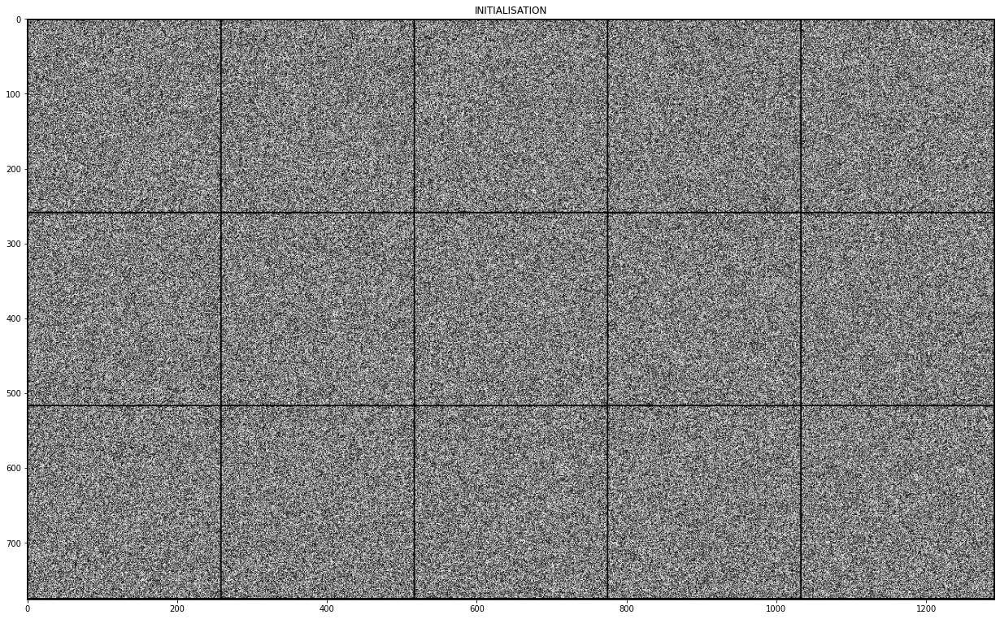

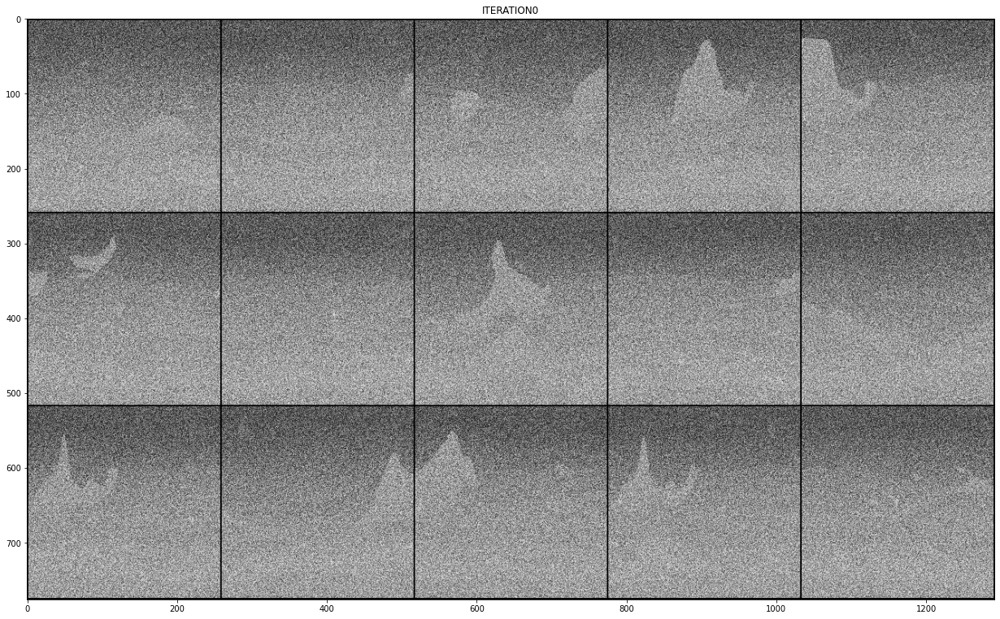

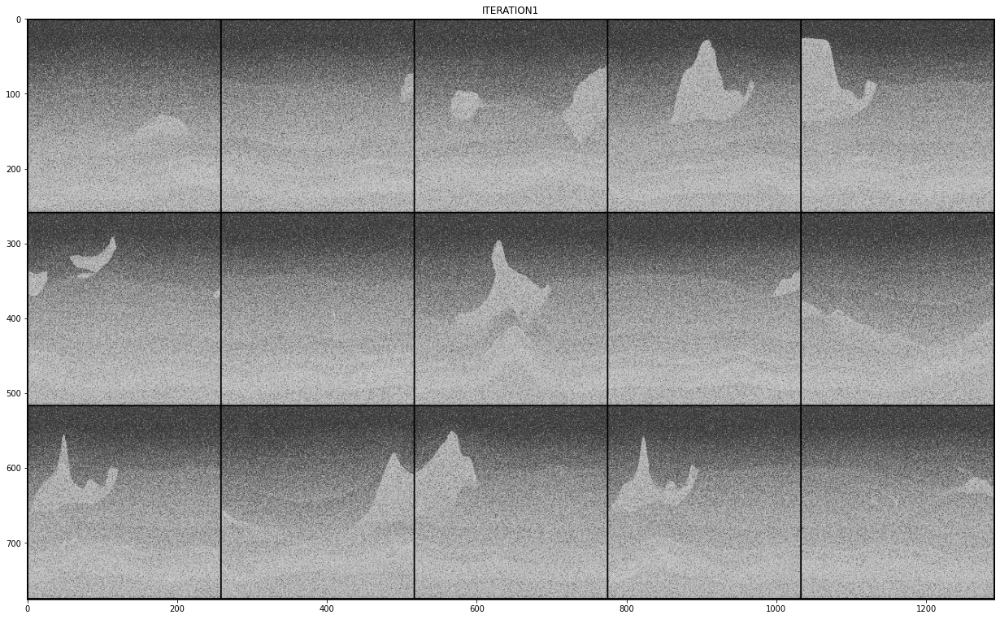

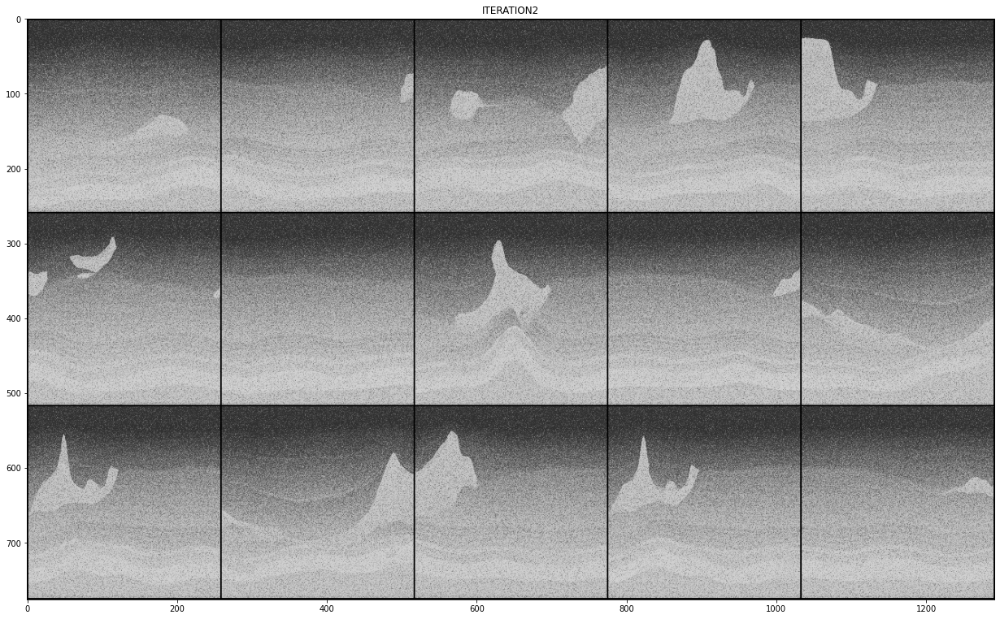

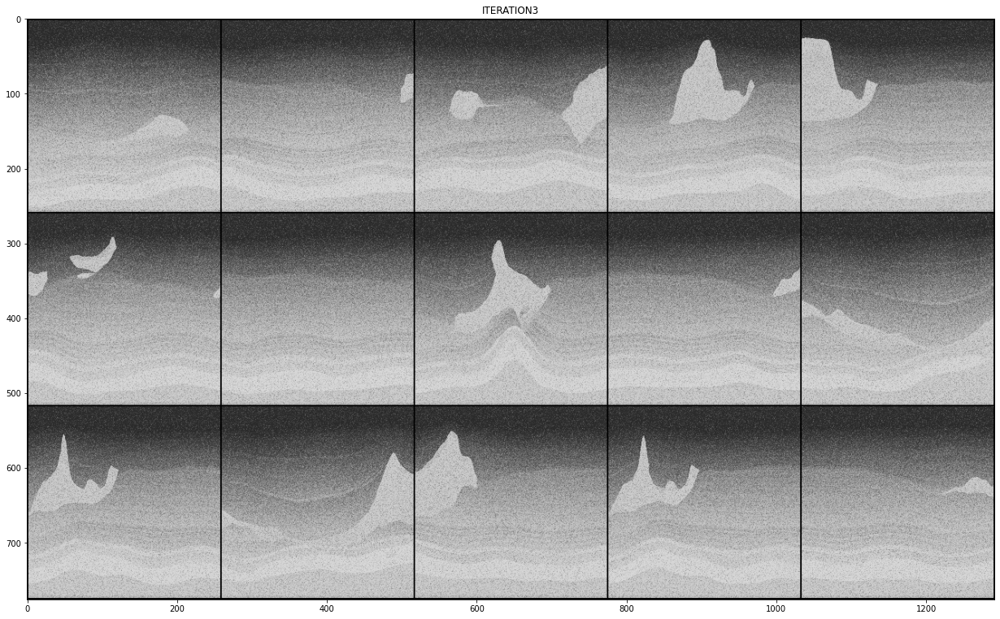

...

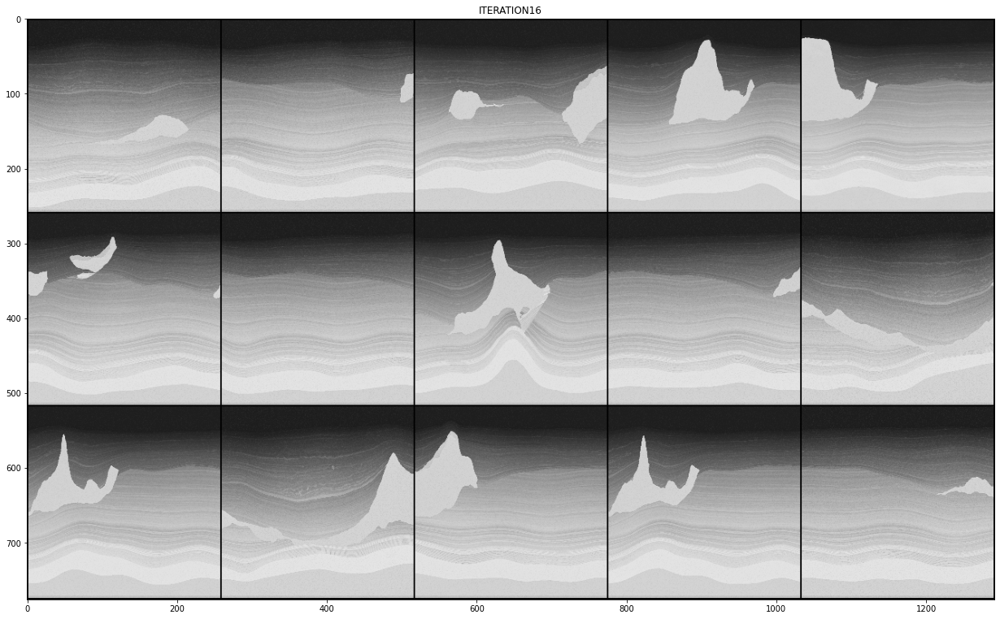

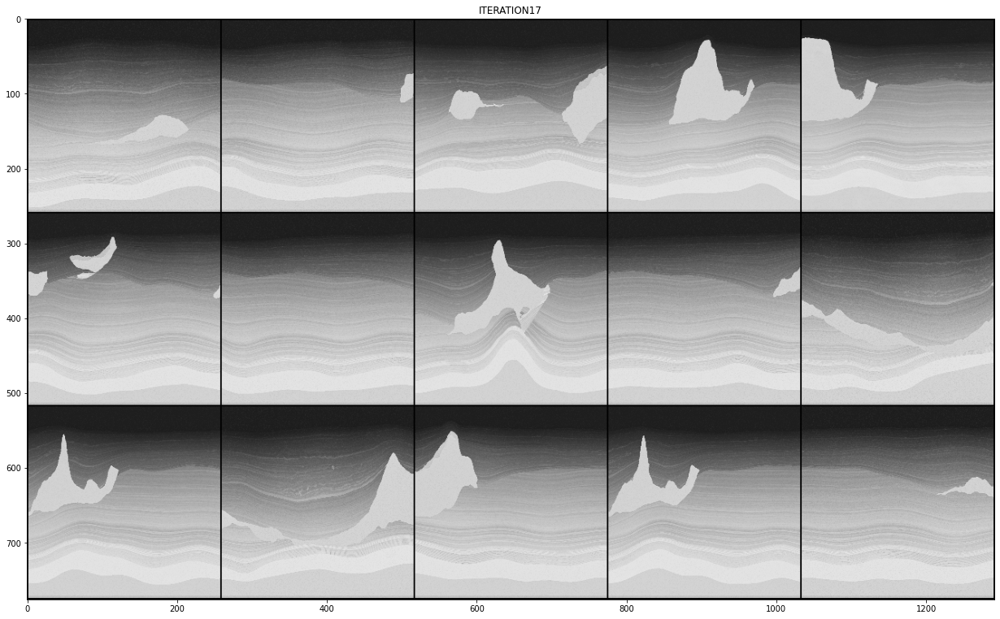

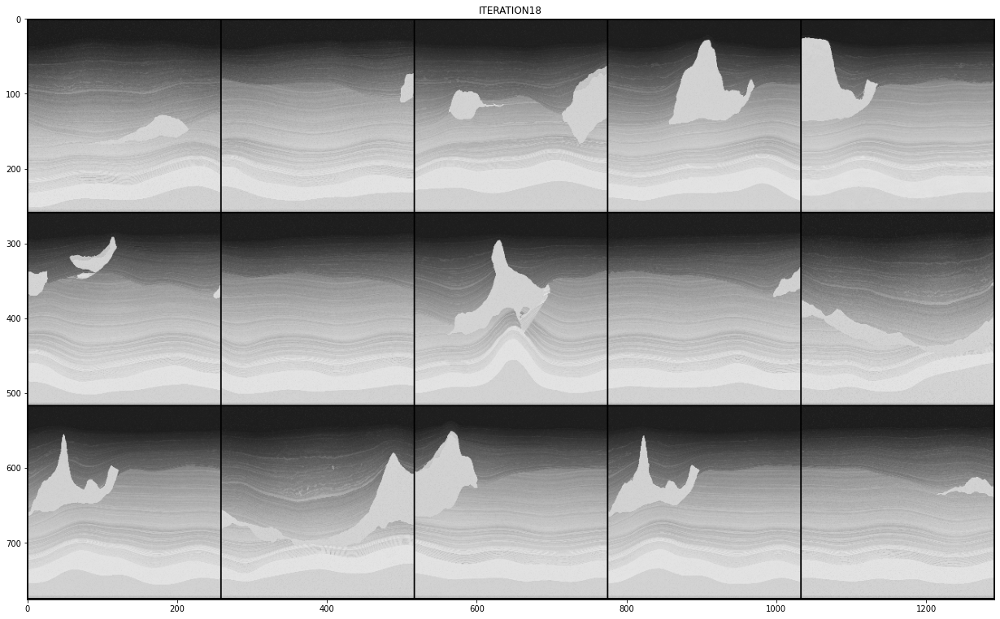

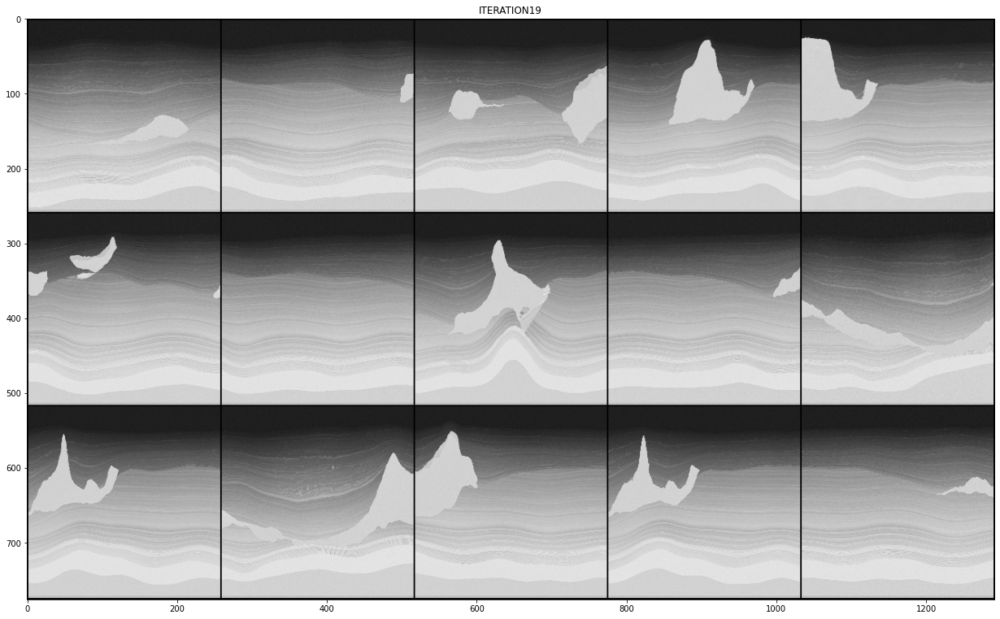

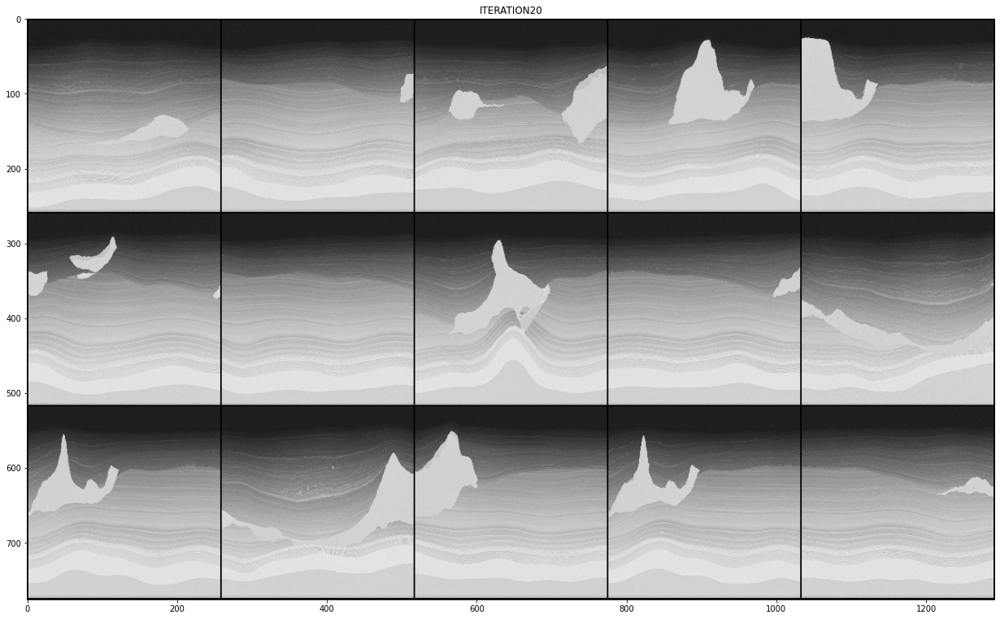

In [15]:
sample = x0.cpu()

sample = torch.clamp(sample, 0.0, 1.0)

grid_img = torchvision.utils.make_grid(sample, nrow=5)

dpi = matplotlib.rcParams['figure.dpi']

height = width = 6*256
figsize = width / float(dpi), height / float(dpi)

plt.figure(figsize=figsize)
plt.title("INITIALISATION")
plt.imshow(grid_img.permute(1, 2, 0))
plt.show()

for i in range(len(all_samples)):
    sample = all_samples[i].view(all_samples[i].shape[0], new_config.data.channels,
                                  new_config.data.image_size,
                                  new_config.data.image_size)

    sample = torch.clamp(sample, 0.0, 1.0)

    grid_img = torchvision.utils.make_grid(sample, nrow=5)

    dpi = matplotlib.rcParams['figure.dpi']

    height = width = 6*256
    figsize = width / float(dpi), height / float(dpi)

    plt.figure(figsize=figsize)
    plt.title("ITERATION" + str(i))
    plt.imshow(grid_img.permute(1, 2, 0))
    plt.show()

print(len(all_samples))

print(all_samples[0].shape)

samples_to_save = torch.zeros((len(all_samples) + 3, 15, 1, 256, 256))
print(samples_to_save.shape)

samples_to_save[0] = noisy_test_sample.cpu()
samples_to_save[1] = x0.cpu()
samples_to_save[-1] = test_sample.cpu()

for i in range(len(all_samples)):
    samples_to_save[i+2] = all_samples[i]

for i in range(samples_to_save.shape[0]):
    sample = samples_to_save[i].view(samples_to_save[i].shape[0], new_config.data.channels,
                                  new_config.data.image_size,
                                  new_config.data.image_size)

    sample = torch.clamp(sample, 0.0, 1.0)

    grid_img = torchvision.utils.make_grid(sample, nrow=5)

    dpi = matplotlib.rcParams['figure.dpi']

    height = width = 6*256
    figsize = width / float(dpi), height / float(dpi)

    plt.figure(figsize=figsize)
    plt.title("ITERATION" + str(i))
    plt.imshow(grid_img.permute(1, 2, 0))
    plt.show()